In [8]:
import matplotlib.pyplot as plt 
import torch 
from numpy import linalg as la
import numpy as np 
from sklearn.decomposition import PCA
# svd iniziale e dopo la rotazione 
# Dopo FFNN e attention projection


In [9]:
def svd(vectors, name = 'vectors', text = False, values = False):
    
    if type(vectors) == torch.Tensor:
        vectors = vectors.detach().numpy()
    elif type(vectors) == torch.nn.parameter.Parameter:
        vectors = vectors.detach().numpy()
    
    N = vectors.shape[0]
    U, spectrum, Vt = la.svd(vectors)
    l_svd = (spectrum ** 2)/(N-1)
    V_svd = U

    fig, axes = plt.subplots(1, 2, figsize=(12,5))
    axes[0].plot(l_svd/sum(l_svd)*100)
    axes[0].set_xlim(0,10)
    axes[0].set_xlabel('Component')
    axes[0].set_ylabel('% over the total variance')
    axes[0].grid()

    axes[1].plot(np.cumsum(l_svd/sum(l_svd)*100))
    axes[1].set_xlabel('Component')
    axes[1].set_ylabel('Cumulative sum over total variance [%]')
    axes[1].grid()
    axes[1].plot()


    fig.suptitle(f'SVD for the {name} matrix', fontsize=16)

    plt.show()

    if text == True:
       print(f'Eigenvalues ({name} matrix): \n', Vt.transpose())
       print('\n')
       print(f'Eigenvectors ({name} matrix): \n', U)

    elif values == True:
       return U, spectrum, Vt # remove the comment to obtain the eigenvectors and eigenvalues 

In [12]:
def svd_and_pca(vectors, name = 'vectors', text = False, values = False, cmap = True, n_components = 3):
    
    
    if type(vectors) == torch.Tensor:
        vectors = vectors.detach().numpy()
        
    elif type(vectors) == torch.nn.parameter.Parameter:
        vectors = vectors.detach().numpy()
    
    N = vectors.shape[0]
    U, spectrum, Vt = la.svd(vectors)
    l_svd = (spectrum ** 2)/(N-1)
    V_svd = U

    fig, axes = plt.subplots(1, 2, figsize=(12,5))
    axes[0].plot(l_svd/sum(l_svd)*100)
    axes[0].set_xlim(0,10)
    axes[0].set_xlabel('Component')
    axes[0].set_ylabel('% over the total variance')
    axes[0].grid()

    axes[1].plot(np.cumsum(l_svd/sum(l_svd)*100))
    axes[1].set_xlabel('Component')
    axes[1].set_ylabel('Cumulative sum over total variance [%]')
    axes[1].grid()
    axes[1].plot()


    fig.suptitle(f'SVD for the {name} matrix', fontsize=16)

    if text == True:
       print(f'Eigenvalues ({name} matrix): \n', Vt.transpose())
       print('\n')
       print(f'Eigenvectors ({name} matrix): \n', U)


    pca = PCA(n_components)

    principal_components = pca.fit_transform(vectors)

    indices = np.arange(0,vectors.shape[0])
   
    x = principal_components[:,0]
    y = principal_components[:,1]
    z = principal_components[:,2]

    #ax.plot_surface(x, y, z, cmap = 'viridis')
    fig = plt.figure(figsize=(16,8))
    axes = fig.add_subplot(121, projection='3d')

    axes.scatter(x, y, z, c=indices)
    axes.set_xlabel('PCA 1')
    axes.set_ylabel('PCA 2')
    axes.set_zlabel('PCA 3')
    axes.set_title(f'{name} PCA')

    if cmap == True:
       ax2 = fig.add_subplot(122)
       heatmap = ax2.imshow(np.log(np.abs(vectors) + 1), cmap='inferno')
       fig.colorbar(heatmap, ax=ax2, shrink = 0.4)
       ax2.set_title(f'{name} weight')

    # Mostra il plot
    plt.show()

    if values == True:
       return U, spectrum, Vt # remove the comment to obtain the eigenvectors and eigenvalues 
        

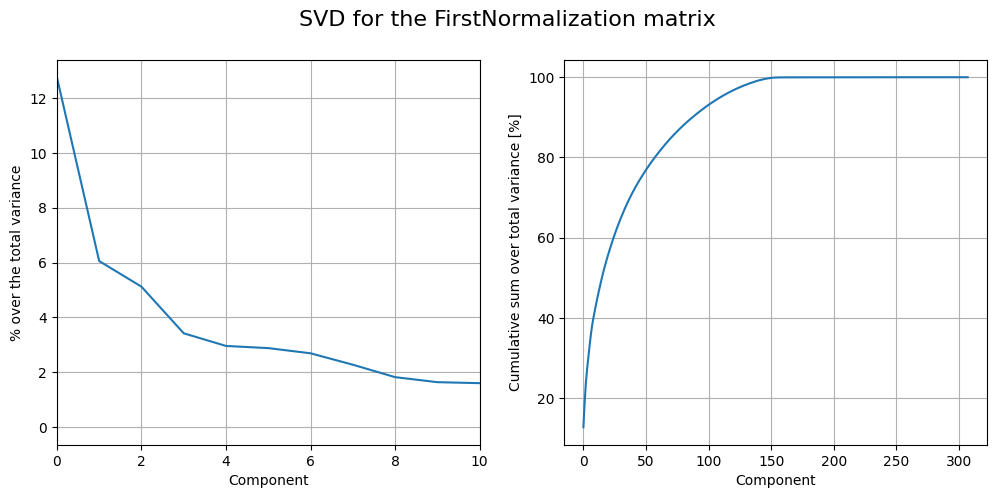

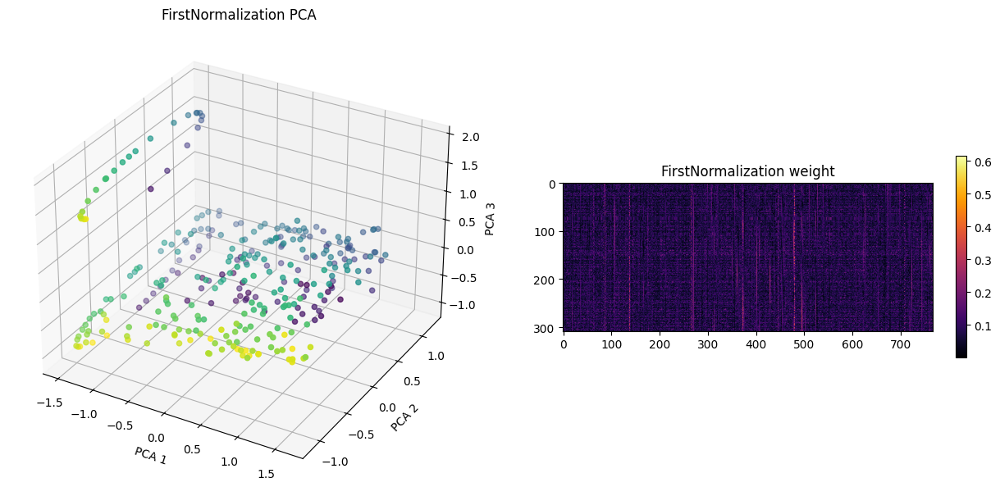

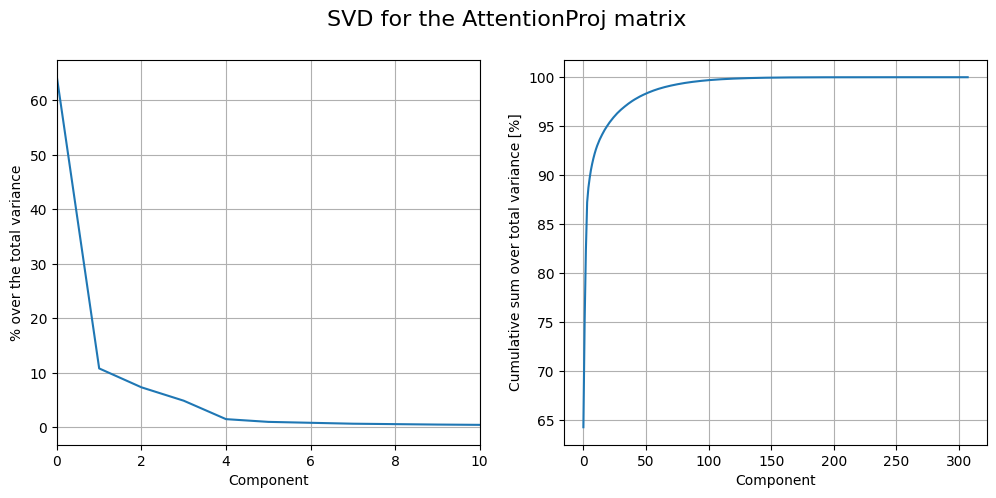

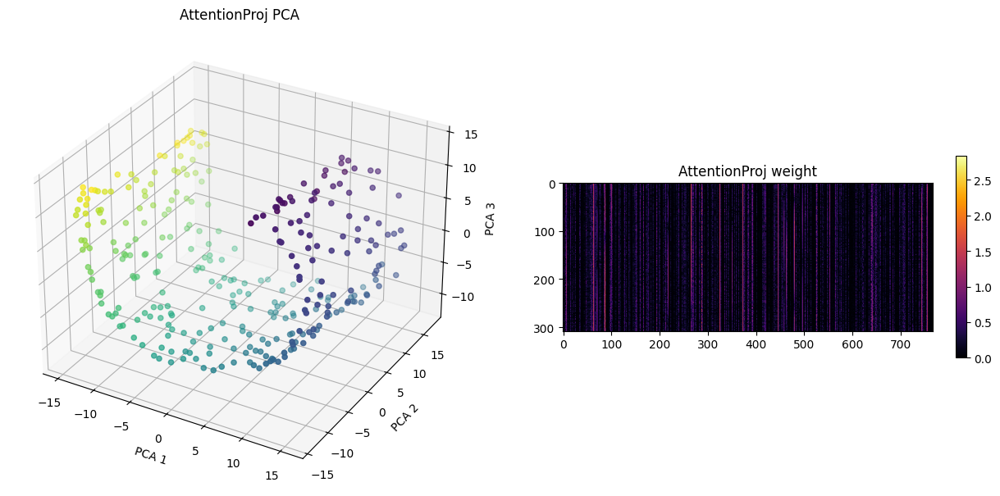

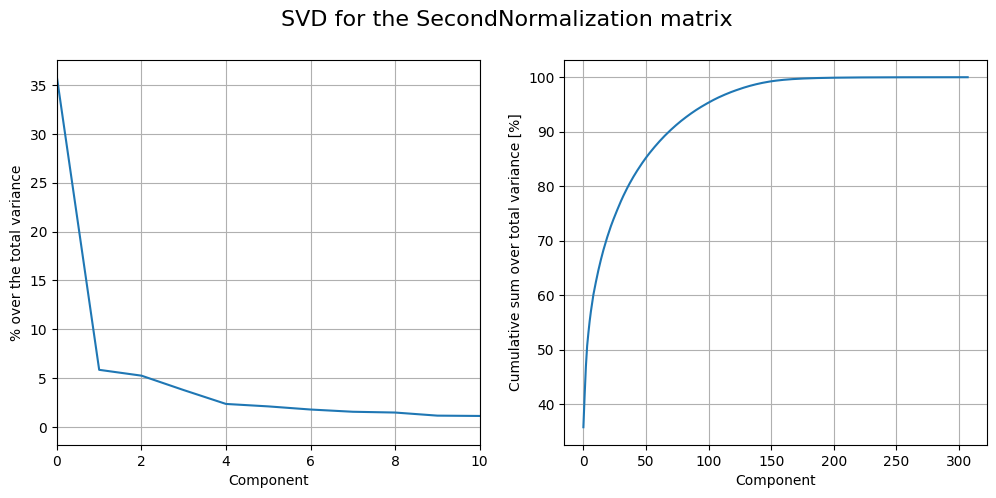

...

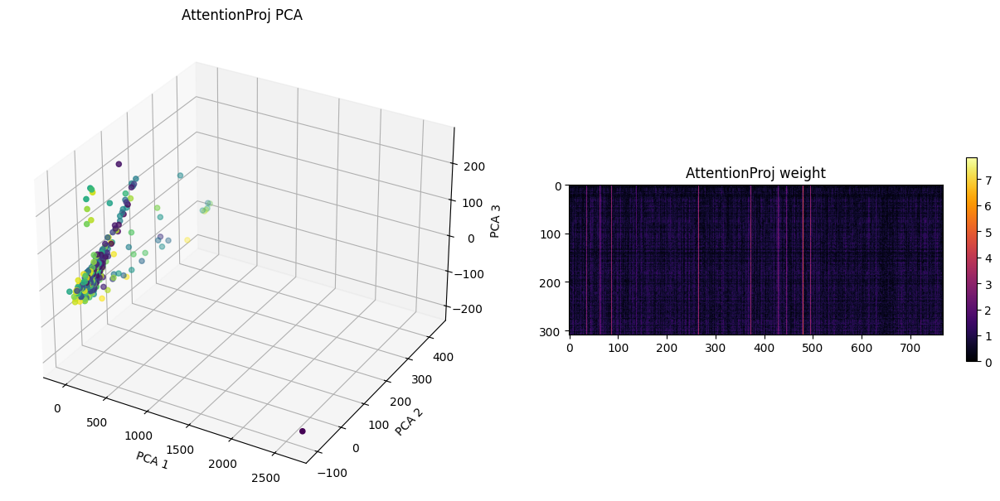

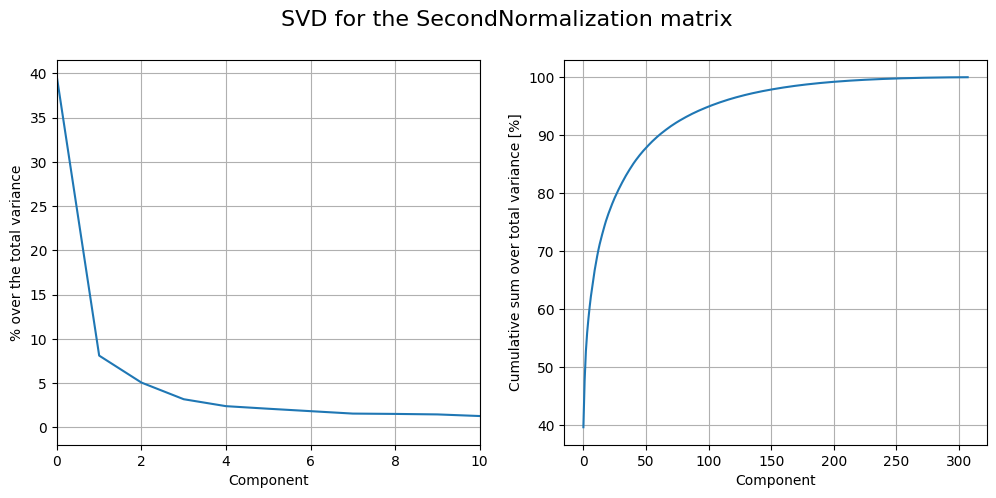

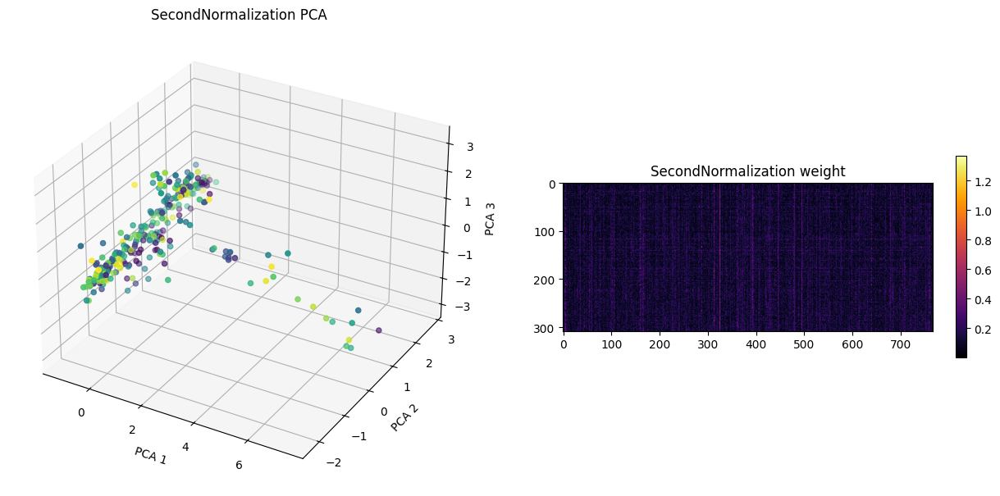

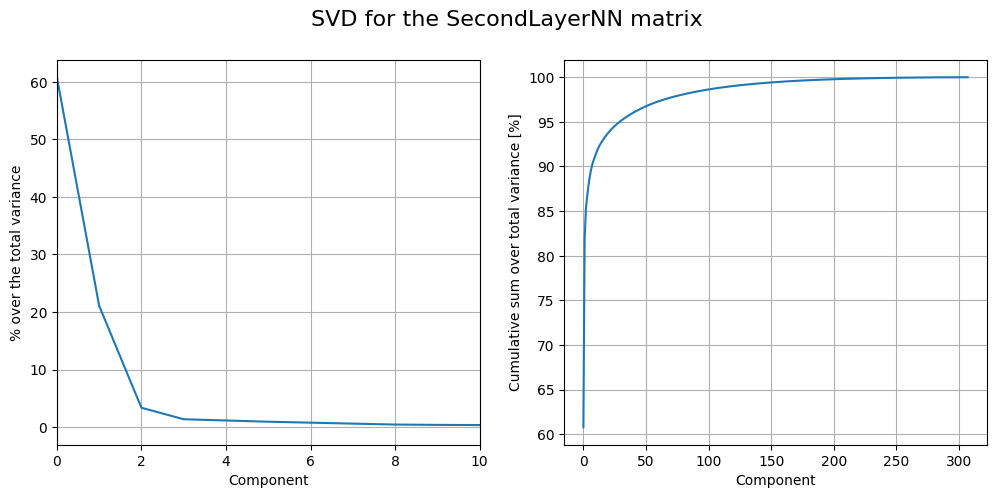

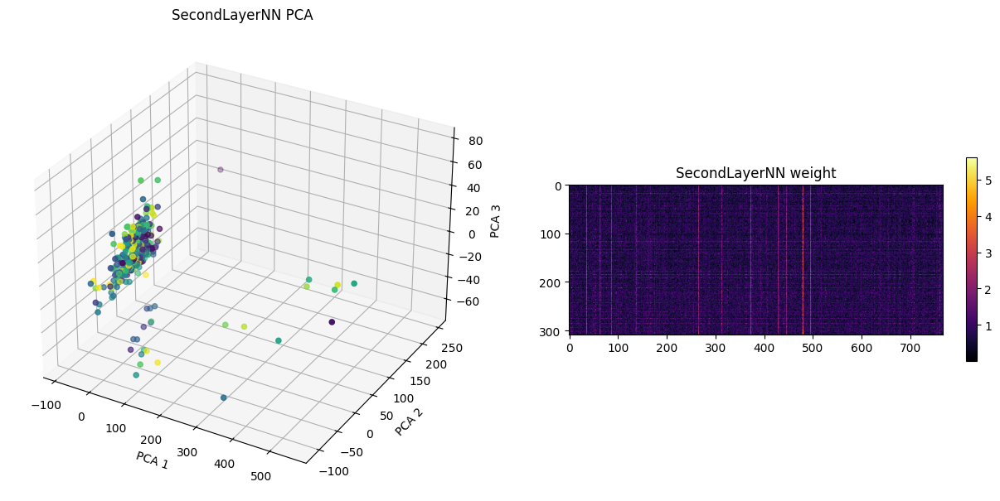

In [13]:
# Prendere vettori iniziali da file prompt embedding 
'''
Decoder_01_FirstNormalization  = output_list[3]
Decoder_01_QKV_representation  = output_list[4]
Decoder_01_AttentionHeads      = output_list[5]
Decoder_01_AttentionProj       = output_list[7]
Decoder_01_SecondNormalization = output_list[9]
Decoder_01_FirstLayerNN        = output_list[11]
Decoder_01_SecondLayerNN       = output_list[13]
'''

string = ['FirstNormalization', 'AttentionProj', 'SecondNormalization', 'SecondLayerNN']

for i in range(12): # print per tutti i decoder 
    for line in string: # print per ogni elemento della stringa
        vectors = torch.load(f"output/decoder/decoder_{i+1}/{line}.pt").detach().numpy()[0]
        svd_and_pca(vectors, name = str(line))
    
